In [7]:
import numpy as np
from os import listdir
from PIL import Image, ImageDraw
import xml.etree.ElementTree as ET 
import xmltodict
import matplotlib.pyplot as plt
import matplotlib.image as img
import glob
import os

import pyvips
import pylibczi
from pylibczi import CziScene
import czifile
from czifile import CziFile 
# import pyvips as vips

import vips_utils


""" Convert np array to vips """
dtype_to_format = {
    'uint8': 'uchar',
    'int8': 'char',
    'uint16': 'ushort',
    'int16': 'short',
    'uint32': 'uint',
    'int32': 'int',
    'float32': 'float',
    'float64': 'double',
    'complex64': 'complex',
    'complex128': 'dpcomplex'
}

def numpy2vips(a):
    height, width, bands = a.shape
    linear = a.reshape(width * height * bands)
    vi = pyvips.Image.new_from_memory(linear.data, width, height, bands,
                                      dtype_to_format[str(a.dtype)])
    return vi

In [8]:
CZI_PATH = '../data/Batch_01_Original_CZI_files/'
CZ_PATH = '../data/Uploads_with_Corrections/'

In [4]:
filenames = sorted(os.listdir(CZI_PATH))
filenames

['1-102-Temporal_AT8.czi',
 '1-154-Temporal_AT8.czi',
 '1-209-Temporal_AT8.czi',
 '1-225-Temporal_AT8.czi',
 '1-254-Temporal_AT8.czi',
 '1-271-Temporal_AT8.czi',
 '1-290-Temporal_AT8.czi',
 '1-297-Temporal_AT8.czi',
 '1-466-Temporal_AT8.czi',
 '1-516-Temporal_AT8.czi',
 '1-573-Temporal_AT8.czi',
 '1-621-Temporal_AT8.czi',
 '1-693-Temporal_AT8.czi',
 '1-695-Temporal_AT8.czi',
 '1-717-Temporal_AT8.czi',
 '1-751-Temporal_AT8.czi',
 '1-755-Temporal_AT8.czi',
 '1-756-Temporal_AT8.czi',
 '1-838-Temporal_AT8.czi',
 '1-907-Temporal_AT8.czi',
 '1-923-Temporal_AT8.czi',
 '1-960-Temporal_AT8.czi']

In [5]:
filenames = ['1-102-Temporal_AT8.czi',
 '1-154-Temporal_AT8.czi',
#  '1-209-Temporal_AT8.czi',
#  '1-225-Temporal_AT8.czi',
#  '1-254-Temporal_AT8.czi',
 '1-271-Temporal_AT8.czi',
#  '1-290-Temporal_AT8.czi',
 '1-297-Temporal_AT8.czi',
 '1-466-Temporal_AT8.czi',
 '1-516-Temporal_AT8.czi',
 '1-573-Temporal_AT8.czi',
 '1-621-Temporal_AT8.czi',
 '1-693-Temporal_AT8.czi',
 '1-695-Temporal_AT8.czi',
 '1-717-Temporal_AT8.czi',
#  '1-751-Temporal_AT8.czi',
#  '1-755-Temporal_AT8.czi',
 '1-756-Temporal_AT8.czi',
#  '1-838-Temporal_AT8.czi',
 '1-907-Temporal_AT8.czi',
 '1-923-Temporal_AT8.czi',
 '1-960-Temporal_AT8.czi']

In [5]:
for filename in filenames:
    try:
        print(filename)
        img = czifile.imread(CZI_PATH + filename)
        print(filename, img.shape)
        del img
    except Exception as e:
        print(e)
    continue

    

1-102-Temporal_AT8.czi
1-102-Temporal_AT8.czi (1, 1, 116676, 115406, 3)
1-154-Temporal_AT8.czi
1-154-Temporal_AT8.czi (1, 1, 147978, 259435, 3)
1-209-Temporal_AT8.czi
Unable to allocate 481. GiB for an array with shape (5, 1, 119985, 286828, 3) and data type uint8
1-225-Temporal_AT8.czi
Unable to allocate 248. GiB for an array with shape (2, 1, 153387, 289696, 3) and data type uint8
1-254-Temporal_AT8.czi
not a ZISRAW segment
1-271-Temporal_AT8.czi
1-271-Temporal_AT8.czi (1, 1, 136097, 135564, 3)
1-290-Temporal_AT8.czi
Unable to allocate 234. GiB for an array with shape (3, 1, 116733, 239283, 3) and data type uint8
1-297-Temporal_AT8.czi
1-297-Temporal_AT8.czi (1, 1, 195271, 240746, 3)
1-466-Temporal_AT8.czi
1-466-Temporal_AT8.czi (1, 1, 176073, 299777, 3)
1-516-Temporal_AT8.czi
1-516-Temporal_AT8.czi (1, 1, 144670, 230657, 3)
1-573-Temporal_AT8.czi
1-573-Temporal_AT8.czi (1, 1, 116557, 95263, 3)
1-621-Temporal_AT8.czi
1-621-Temporal_AT8.czi (1, 1, 99385, 147110, 3)
1-693-Temporal_AT8.

In [ ]:
image = '1-573-Temporal_AT8.czi'
img = czifile.imread(CZI_PATH + image)
print(img.shape)

In [5]:
img[0,0,50000,40000,2]

165

In [5]:
numpy_array = np.array(img, dtype = np.uint8)

scenes = numpy_array.shape[0]
time = numpy_array.shape[1]
height = numpy_array.shape[2]
width = numpy_array.shape[3]
channels = numpy_array.shape[4]

# numpy_array_reshaped = numpy_array.reshape((height*scenes, width, channels))
# numpy_array_reshaped = numpy_array.reshape((height, width, channels))
numpy_array_reshaped = numpy_array.reshape((width, height, channels))
print(numpy_array_reshaped.shape) 

(116557, 95263, 3)


In [7]:
numpy_array_reshaped[50000,50000,1]

152

In [6]:
vips = numpy2vips(numpy_array_reshaped) 
vips   

<pyvips.Image 95263x116557 uchar, 3 bands, srgb>

In [7]:
# ## Read .cz metadata files - uploaded with the .czi images
# metadata_xml = image.split('.')[0]
# metadata_name = metadata_xml + '.cz'
# doc = xmltodict.parse(open(PATH_NFT + metadata_name, 'r').read())
doc = xmltodict.parse(open(CZ_PATH + '1-573-Temporal_AT8.cz', 'r', encoding='utf-8').read())
# doc

In [8]:
# ## Extract rectangles, annotations and scaling factor from the metadata 
def extract_rectangles_cz(PATH, metadata_xml):
    """
    Method to extract the coordinates of rectangles drawn on the image 
    
    input: PATH and metadata name 
    
    
    return: 
    rectangles: dictionnary
    
    {
    'rectangle_1': [Left, Top, Width, Height],
    'rectangle_2': [...],
    
    ...}
    
    """
    
    rectangles = {}
    
    metadata_name = PATH + metadata_xml
    doc = xmltodict.parse(open(metadata_name, 'r', encoding='utf-8').read())
    dic_rectangle = doc['GraphicsDocument']['Elements']['Rectangle']

    for rect in range(0, len(dic_rectangle)):
        geometry = dic_rectangle[rect]['Geometry']
        rectangles['rectangle_{}'.format(rect)] = [geometry['Left'], geometry['Top'], geometry['Width'], geometry['Height']]
        
    return(rectangles)

In [9]:
def extract_annotations_coordinates_cz(PATH, metadata_xml):
    """
    Method to extract the annotations (points) drawn on the image
    
    input: PATH and metadata name 
    
    return: dictionnary of annotations (X,Y)
    
    {
    'annotation_1': [X_1, Y_1], 
    'annotation_1': [X_2, Y_2],
    ...
    }
    
    """
    
    annotations = {}
    
    metadata_name = PATH + metadata_xml
    doc = xmltodict.parse(open(metadata_name, 'r', encoding='utf-8').read())
    dic_marker = doc['GraphicsDocument']['Elements']['Marker']

    for coordinate in range(0, len(dic_marker)):
        geometry = dic_marker[coordinate]['Geometry']
        annotations['annotation_{}'.format(coordinate)] = [int(float(geometry['X'])), int(float(geometry['Y']))]

    return(annotations)

In [10]:
def extract_scaling_factor_cz(PATH, metadata_xml):
    """
    Extract the scaling factor 
    
    input: PATH and metadata name 
    return: float 
    """
    
    metadata_name = PATH + metadata_xml
    doc = xmltodict.parse(open(metadata_name, 'r', encoding='utf-8').read())

    scaling_factor = doc['GraphicsDocument']['Scaling']['Items']['Distance'][0]['Value']
    scaling_factor = float(scaling_factor)
    
    return(scaling_factor)

In [11]:
PATH_NFT = CZ_PATH
metadata_name = '1-102-Temporal_AT8.cz'
rectangles = extract_rectangles_cz(PATH_NFT, metadata_name)
annotations = extract_annotations_coordinates_cz(PATH_NFT, metadata_name)
scaling_factor = extract_scaling_factor_cz(PATH_NFT, metadata_name)

print(len(rectangles), 'rectangles')
print(len(annotations), 'annotations')
print(scaling_factor)

3 rectangles
288 annotations
1.1110249786190817e-07


In [12]:
print(rectangles)

{'rectangle_0': ['17185.150382847707', '87276.585790600686', '21236.476417759448', '10680.909092068709'], 'rectangle_1': ['14026.024376458226', '35351.831030217305', '21236.476417759448', '10680.909092068709'], 'rectangle_2': ['33989.75600585097', '19115.767132453762', '21236.476417759448', '10680.909092068709']}


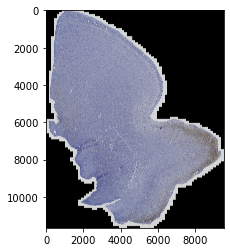

In [16]:
'''
Debug here!
'''


import pyvips as Vips
NP_DTYPE_TO_VIPS_FORMAT = {
        np.dtype('int8'): Vips.BandFormat.CHAR,
        np.dtype('uint8'): Vips.BandFormat.UCHAR,
        np.dtype('int16'): Vips.BandFormat.SHORT,
        np.dtype('uint16'): Vips.BandFormat.USHORT,
        np.dtype('int32'): Vips.BandFormat.INT,
        np.dtype('float32'): Vips.BandFormat.FLOAT,
        np.dtype('float64'): Vips.BandFormat.DOUBLE
    }

VIPS_FORMAT_TO_NP_DTYPE = {v:k for k, v in NP_DTYPE_TO_VIPS_FORMAT.items()}

def array_vips(vips_image, verbose=False):
    # dtype = np.dtype('u{}'.format(vips_image.BandFmt.bit_length() + 1))
    dtype = VIPS_FORMAT_TO_NP_DTYPE[vips_image.format]
    if verbose:
        print(dtype, vips_image.height, vips_image.width, vips_image.bands)
    return (np.fromstring(vips_image.write_to_memory(), dtype=dtype) #np.uint8)
             .reshape(vips_image.height, vips_image.width, vips_image.bands)).squeeze()
#     return (np.fromstring(vips_image.write_to_memory(), dtype=np.uint8)
#              .reshape(vips_image.height, vips_image.width, vips_image.bands)).squeeze()


# map vips formats to np dtypes
format_to_dtype = {
    'uchar': np.uint8,
    'char': np.int8,
    'ushort': np.uint16,
    'short': np.int16,
    'uint': np.uint32,
    'int': np.int32,
    'float': np.float32,
    'double': np.float64,
    'complex': np.complex64,
    'dpcomplex': np.complex128,
}

# vips image to numpy array
def vips2numpy(vi):
    return np.ndarray(buffer=vi.write_to_memory(),
                      dtype=format_to_dtype[vi.format],
                      shape=[vi.height, vi.width, vi.bands])

def img_frombytes(data):
    size = data.shape[::-1]
    databytes = np.packbits(data, axis=1)
    return Image.frombytes(mode='1', size=size, data=databytes)

vips_resized = vips.resize(0.1)
# im_np = array_vips(vips_resized)
# print(np.where(im_np != 0))
im_np = vips2numpy(vips_resized)
plt.imshow(im_np)
plt.show()

width: 9527 height: 11656


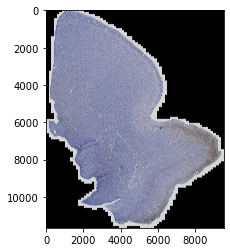

In [13]:
""" Resize image down """

vips_resized = vips.resize(0.1) # 40x magnification --> resize to scale down to 20x 

width = vips_resized.width
height = vips_resized.height
print('width:', width, 'height:', height)

plt.rcParams['savefig.dpi'] = 800
plt.rcParams['figure.dpi'] = 800
plt.axis('off')
vips_utils.show_vips(vips_resized)

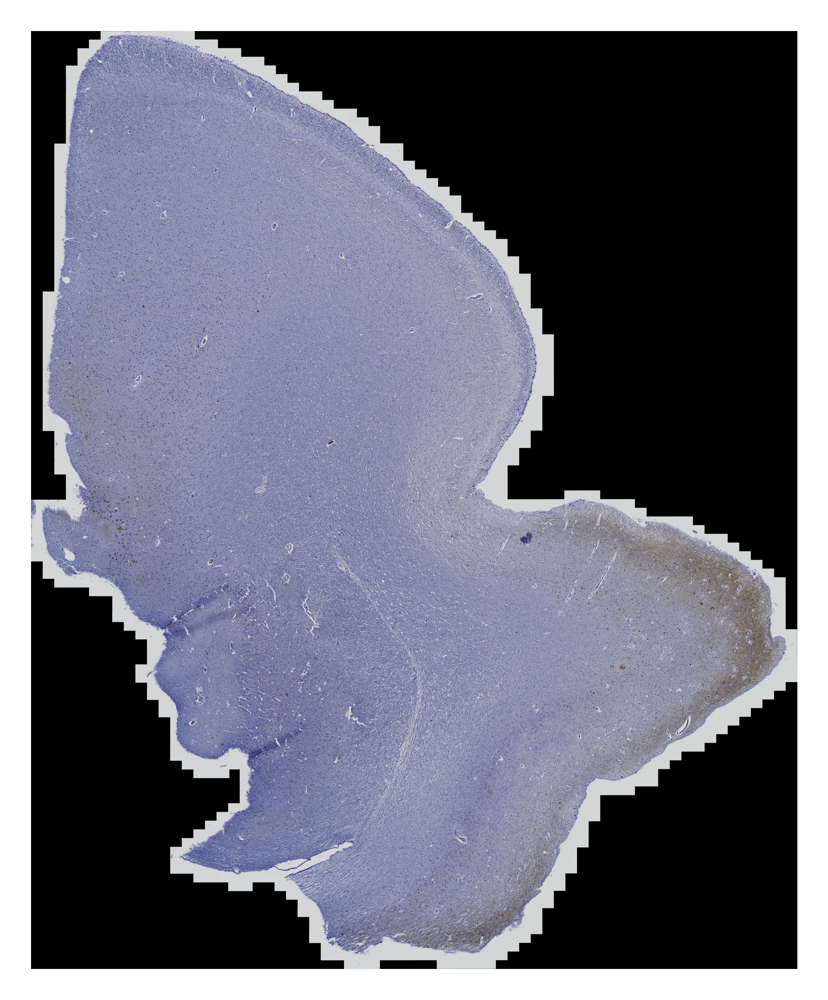

In [18]:
plt.rcParams['savefig.dpi'] = 800
plt.rcParams['figure.dpi'] = 800
plt.axis('off')
vips_utils.show_vips(vips_resized)

scaling factor: 0.1


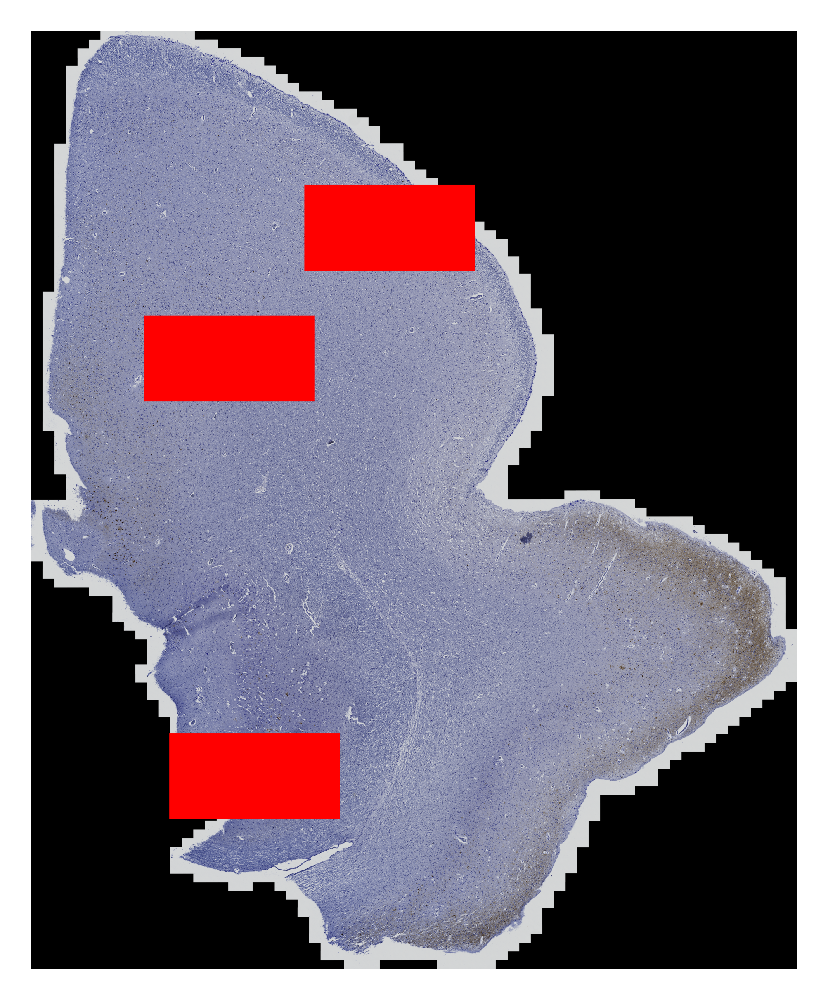

In [20]:
""" Draw rectangles where the annotations are """

vips_resized = vips.resize(0.1) # 40x magnification --> resize to scale down to 20x 

#scaling_factor = extract_scaling_factor_cz(PATH_NFT, metadata_name)
scaling_factor = 0.1

print('scaling factor:', scaling_factor)
color = [255,0,0]
#thumbnail = vips.thumbnail_image(int(float(vips.get("width"))))

for i in range(0, len(rectangles)):
    coord = rectangles['rectangle_{}'.format(i)]
    left = int(float(coord[0])) * scaling_factor
    top = int(float(coord[1])) * scaling_factor
    width = int(float(coord[2])) * scaling_factor
    height = int(float(coord[3])) * scaling_factor
    vips_resized = vips_resized.draw_rect(color, left, top, width, height, fill=True)
    
plt.axis('off')    
vips_utils.show_vips(vips_resized)

scaling factor: 0.1


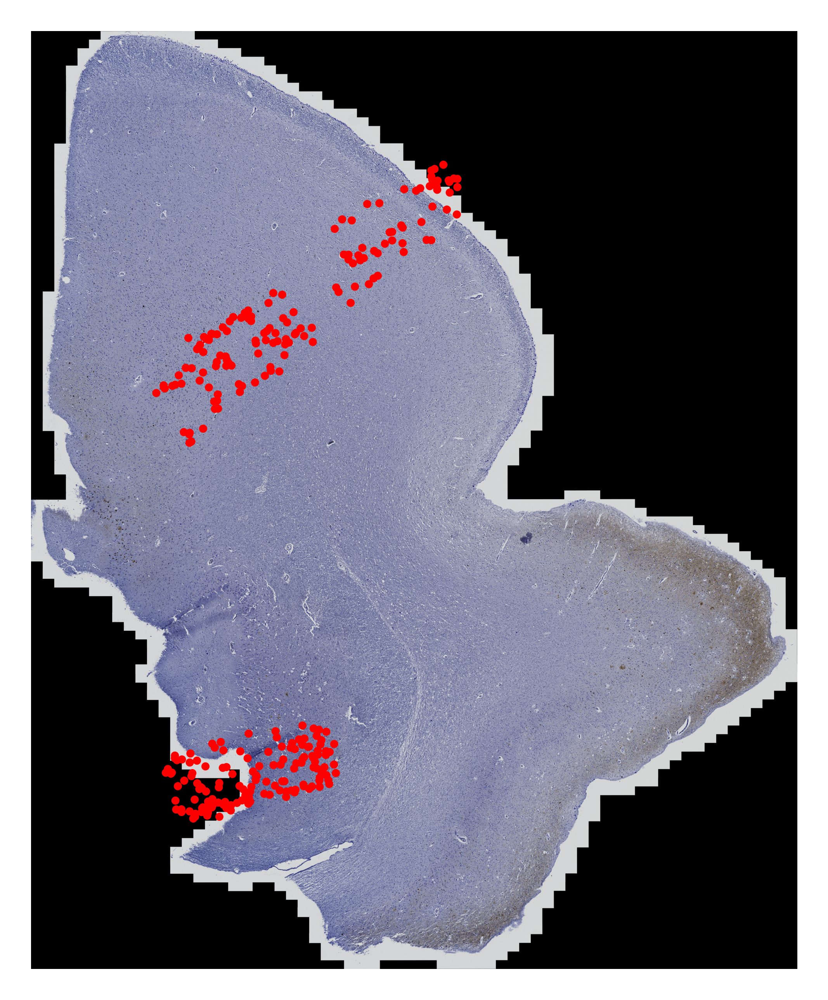

In [21]:
""" Draw annotations based on the coordinate of the metadata """

## resize down the image instead of getting the thumbnail- which takes much more time
vips_resized = vips.resize(0.1) # 40x magnification --> resize to scale down to 20x 

#scaling_factor = extract_scaling_factor_cz(PATH_NFT, metadata_name)
scaling_factor = 0.1

print('scaling factor:', scaling_factor)
color = [255,0,0]
#thumbnail = vips.thumbnail_image(int(float(vips.get("width"))))

for i in range(0, len(annotations)):
    coord = annotations['annotation_{}'.format(i)]
    x = coord[0]*scaling_factor
    y = coord[1]*scaling_factor
    #print(x, y)
    vips_resized = vips_resized.draw_circle(color, x, y, 50, fill=True)
plt.axis('off')    
vips_utils.show_vips(vips_resized)

In [23]:
### Use thumbnail- takes more time 

""" Thumbnail with the right scale """

thumbnail = pyvips.thumbnail_image(int(float(vips.get("width"))))

# thumbnail = pyvips.Image.thumbnail(int(float(vips.get("width"))))
vips_utils.show_vips(thumbnail)

AttributeError: module 'pyvips' has no attribute 'thumbnail_image'

In [22]:
""" Draw annotations based on the coordinate of the metadata """

#scaling_factor = extract_scaling_factor_cz(PATH_NFT, metadata_name)
scaling_factor = 1

print('scaling factor:', scaling_factor)
color = [255,0,0]
thumbnail = vips.thumbnail_image(int(float(vips.get("width"))))

for i in range(0, len(annotations)):
    coord = annotations['annotation_{}'.format(i)]
    x = coord[0]*scaling_factor
    y = coord[1]*scaling_factor
    #print(x, y)
    thumbnail = thumbnail.draw_circle(color, x, y, 50, fill=True)
    
vips_utils.show_vips(thumbnail)

scaling factor: 1


Error: no such operation thumbnail_image
  VipsOperation: class "thumbnail_image" not found


In [24]:
""" Draw rectangles where the annotations are """

#scaling_factor = extract_scaling_factor_cz(PATH_NFT, metadata_name)
scaling_factor = 1

print('scaling factor:', scaling_factor)
color = [255,0,0]
thumbnail = pyvips.thumbnail_image(int(float(vips.get("width"))))

for i in range(0, len(rectangles)):
    coord = rectangles['rectangle_{}'.format(i)]
    left = int(float(coord[0])) * scaling_factor
    top = int(float(coord[1])) * scaling_factor
    width = int(float(coord[2])) * scaling_factor
    height = int(float(coord[3])) * scaling_factor
    thumbnail = thumbnail.draw_rect(color, left, top, width, height, fill=True)
    
    
vips_utils.show_vips(thumbnail)

scaling factor: 1


AttributeError: module 'pyvips' has no attribute 'thumbnail_image'